In [1]:
import anndata as ad
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
import cv2
import geopandas as gpd
from shapely.geometry import Point, Polygon
from scipy.spatial import KDTree
from tqdm import tqdm
from scipy import ndimage
import sklearn
import matplotlib.font_manager as fm
from os.path import join

# Load the data

In [2]:
save_path = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results/striosome_community_detection_sec50_20251005.pkl'
with open(save_path, 'rb') as f:
    adata = pickle.load(f)
adata

AnnData object with n_obs × n_vars = 32557 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color', 'module'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parcellation_organ_palette', 'parcellation_category_palette', 'par

/tmp/ipykernel_3273016/3903501968.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata, color='module', palette=adata.uns['module_palette'],


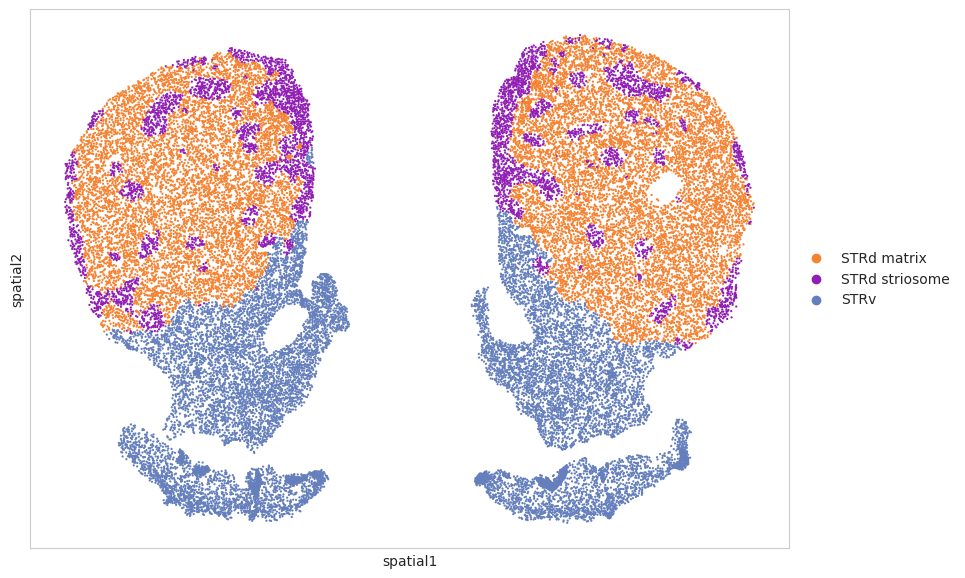

In [3]:
with plt.rc_context({'figure.figsize':(15, 7)}):
    sc.pl.spatial(adata, color='module', palette=adata.uns['module_palette'],
                  spot_size=0.02, title='')

In [4]:
adata.obs['supertype'].dtype

CategoricalDtype(categories=['0166 OB-STR-CTX Inh IMN_1', '0169 OB-STR-CTX Inh IMN_4',
                  '0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
                  '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2',
                  '0238 Sst Chodl Gaba_1', '0239 Sst Chodl Gaba_2',
                  '0240 Sst Chodl Gaba_3', '0245 NDB-SI-MA-STRv Lhx8 Gaba_2',
                  '0247 NDB-SI-MA-STRv Lhx8 Gaba_4',
                  '0250 NDB-SI-MA-STRv Lhx8 Gaba_7',
                  '0251 NDB-SI-MA-STRv Lhx8 Gaba_8',
                  '0253 NDB-SI-MA-STRv Lhx8 Gaba_10',
                  '0254 NDB-SI-MA-STRv Lhx8 Gaba_11',
                  '0258 GPe-SI Sox6 Cyp26b1 Gaba_2',
                  '0260 PAL-STR Gaba-Chol_2', '0261 PAL-STR Gaba-Chol_3',
                  '0262 OT D3 Folh1 Gaba_1', '0263 OT D3 Folh1 Gaba_2',
                  '0264 OT D3 Folh1 Gaba_3', '0265 STR D1 Gaba_1',
                  '0266 STR D1 Gaba_2', '0267 STR D1 Gaba_3',
                  '0268 STR D1 Gaba_4

# Detect striosome contours

In [5]:
X = adata.obsm['spatial'][:, :2]
is_stri = (adata.obs['module'] == 'STRd striosome')

resc = 0.028
Xim = np.round(X[is_stri] / resc).astype(int)
min_ = np.min(Xim,axis=0)
Xim = Xim - min_
imstr = np.zeros(np.max(Xim, axis=0)+1, dtype=np.uint8)
imstr[tuple(Xim.T)] = 1

contours, hierarchy = cv2.findContours(imstr[::1,::1].T, cv2.RETR_EXTERNAL,
                                       cv2.CHAIN_APPROX_SIMPLE)
contour_list, poly_list = [], []
size_thred = 0.2
size_thred = size_thred*resc
for cont in contours:
    # cont: (n_pts, 1, 2)
    # (n_pts, 2)
    cont_ = (np.squeeze(cont, axis=1) + min_)*resc
    if len(cont_) < 4:
        continue
    # filter out small contours
    poly = Polygon(cont_)
    # print(poly.area)
    if poly.area < size_thred:
        continue
    contour_list.append(cont_)
    poly_list.append(poly)

len(contour_list)

32

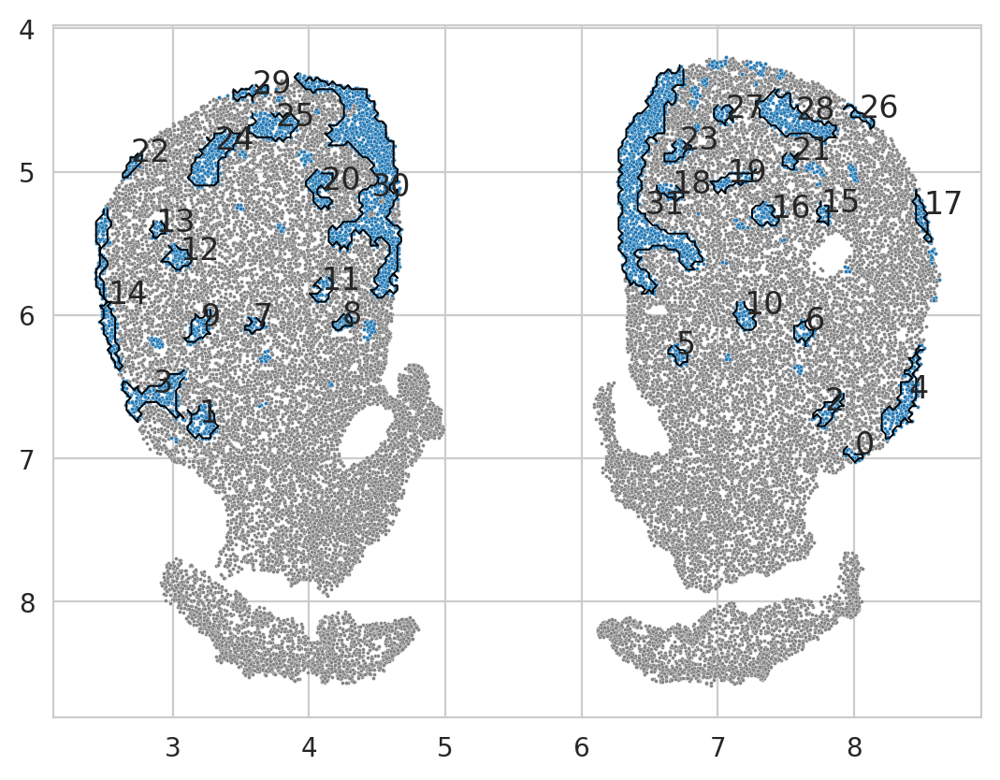

In [6]:
fig,ax = plt.subplots(1,1, dpi=200)
sns.scatterplot(x = X[:,0],y = X[:,1], s=2, c='gray', ax=ax)
sns.scatterplot(x = X[is_stri,0], y = X[is_stri,1], s=2, ax=ax)

for i, cont in enumerate(contour_list):
    ax.plot(cont[:,0],cont[:,1], 'k', lw=0.7)
    # striosome centriod
    striosome_center = np.median(cont, axis=0)
    # ax.text(striosome_center[0],striosome_center[1], f'{i}', fontdict={'fontsize':5})
    ax.text(striosome_center[0],striosome_center[1], f'{i}', fontsize=12)

ax.invert_yaxis()
plt.show()

In [7]:
raw_contour_list, raw_poly_list = contour_list, poly_list

In [8]:
# filter out the striosomes on the egdes
# remove_strios = [19, 26, 31, 32, 33, 29, 21, 3]
# remove_strios = [17, 24, 32, 33, 34, 35, 29, 19, 3]
remove_strios = [3, 14, 22, 29, 30, 31, 26, 17, 4, 0]
contour_list, poly_list = [], []
for i, (cont, poly) in enumerate(zip(raw_contour_list, raw_poly_list)):
    if i in remove_strios:
        continue
    contour_list.append(cont)
    poly_list.append(poly)
print(len(contour_list))


22


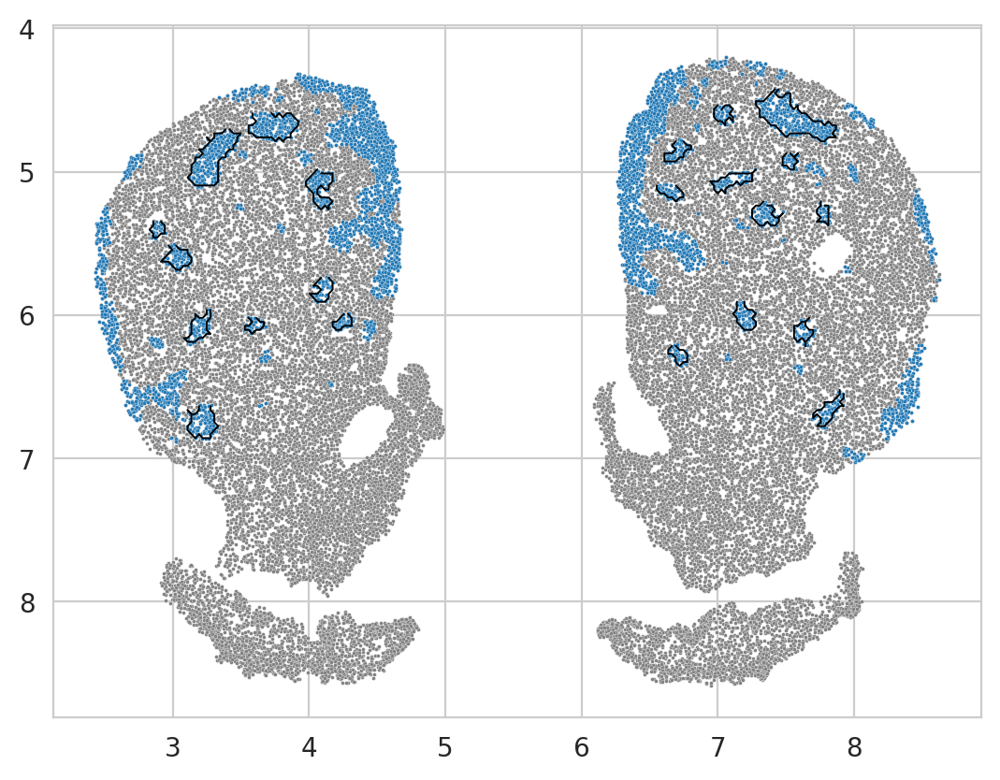

In [9]:
fig,ax = plt.subplots(1,1, dpi=200)
sns.scatterplot(x=X[:,0], y=X[:,1], s=2, c='gray', ax=ax)
sns.scatterplot(x=X[is_stri,0], y=X[is_stri,1], s=2, ax=ax)

for i, cont in enumerate(contour_list):
    ax.plot(cont[:,0],cont[:,1], 'k', lw=0.7)
    # striosome centriod
    striosome_center = np.median(cont, axis=0)
    # ax.text(striosome_center[0],striosome_center[1], f'{i}', fontdict={'fontsize':5})
    # ax.text(striosome_center[0],striosome_center[1], f'{i}', fontsize=9)

ax.invert_yaxis()
plt.show()

In [10]:
# close the border
for i, cont in enumerate(contour_list):
    contour_list[i] = np.concatenate([cont, np.expand_dims(cont[0], axis=0)])

In [11]:
save_dir = '/mnt/Y/Lab/Stereo_seq_data/RL_BG_data/analysis_results/panels/striosome_border/sec50'

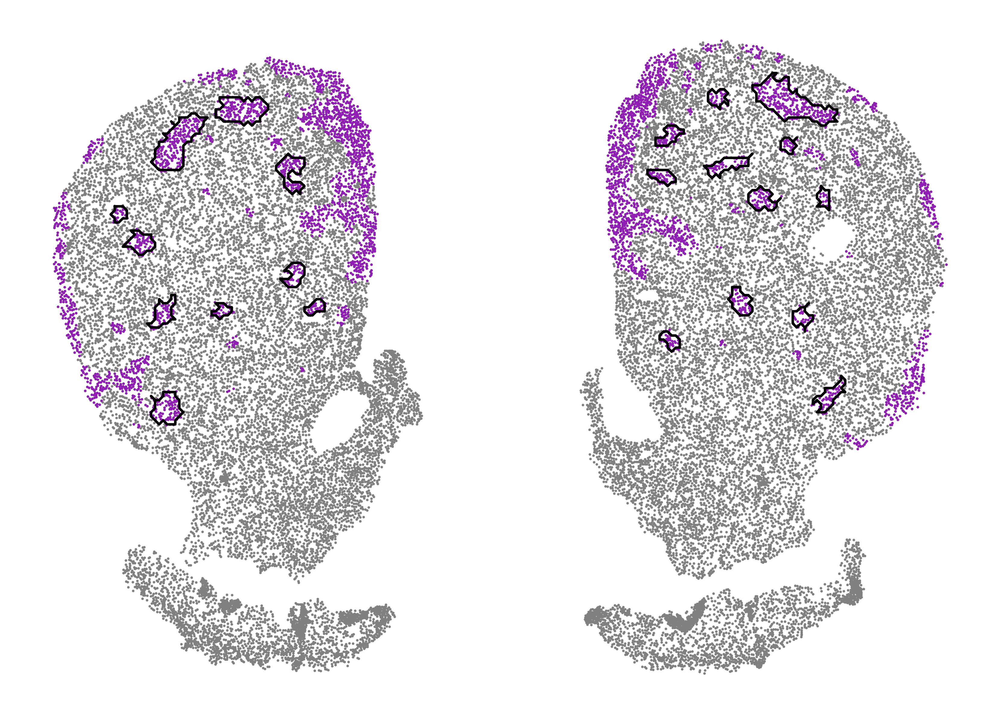

In [12]:
# plot the striosome
fig, ax = plt.subplots(figsize=(14,10), dpi=300)

ax.scatter(x=X[:,0], y=X[:,1], s=1, c='gray')
ax.scatter(x=X[is_stri, 0], y=X[is_stri, 1], c='#911eb4',s=1)

for i, cont in enumerate(contour_list):
    ax.plot(cont[:,0], cont[:,1], 'k', lw=2)
    # striosome centriod
    # striosome_center = np.median(cont, axis=0)
    # ax.text(striosome_center[0],striosome_center[1], f'{i}', fontdict={'fontsize':5})
    # ax.text(striosome_center[0],striosome_center[1], f'{i}', fontsize=9)


# remove grids and axises
ax.grid(False)
ax.axis("off")
ax.invert_yaxis()

plt.savefig(join(save_dir, 'border_detection.tif'), format='tif', bbox_inches='tight')

plt.show()


In [13]:
adata.obs

,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_category,parcellation_division,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color,module
cell_label,,,,,,,,,,,,,,,,,,,,,
1017155956201710149,C57BL6J-638850.50,1347,0.689571,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.649248,5.690118,9.4,...,grey,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome
1017155956201310618,C57BL6J-638850.50,1347,0.601209,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.701504,6.428399,9.4,...,grey,STR,ACB,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv
1017155956101480503-2,C57BL6J-638850.50,1347,0.673859,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.329897,5.711146,9.4,...,grey,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome
1017155956101870678-1,C57BL6J-638850.50,1347,0.700950,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.417584,4.599888,9.4,...,grey,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome
1017155956101870666-1,C57BL6J-638850.50,1347,0.735649,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.416663,4.607488,9.4,...,grey,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017155956100940498-1,C57BL6J-638850.50,5252,0.505079,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.806025,7.527740,9.4,...,grey,STR,ACB,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv
1017155956100260240-1,C57BL6J-638850.50,5252,0.524151,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.497835,8.355297,9.4,...,grey,STR,OT,OT,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv
1017155956101530422-1,C57BL6J-638850.50,5252,0.596046,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.639274,6.129532,9.4,...,grey,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd matrix


In [14]:
# update stiosome labels
stri_adata = adata[adata.obs['module'] == 'STRd striosome']
stri_X = stri_adata.obsm['spatial'][:, :2]

is_stri_covered = np.zeros(len(stri_adata), dtype=np.bool)

for poly in poly_list:
    # striosome cells
    pts_gdf = gpd.GeoDataFrame(
        geometry=[Point(x, y) for x, y in zip(stri_X[:,0], stri_X[:, 1])],
        index=stri_adata.obs.index
    )
    covered = pts_gdf.covered_by(poly)
    is_stri_covered += covered

print('{} / {}'.format(is_stri_covered.sum(), len(stri_adata)))

1358 / 4838


In [15]:
adata.obs['inside_detected_stri'] = False
adata.obs.loc[is_stri_covered.index, 'inside_detected_stri'] = is_stri_covered
adata.obs

,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_division,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color,module,inside_detected_stri
cell_label,,,,,,,,,,,,,,,,,,,,,
1017155956201710149,C57BL6J-638850.50,1347,0.689571,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.649248,5.690118,9.4,...,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False
1017155956201310618,C57BL6J-638850.50,1347,0.601209,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.701504,6.428399,9.4,...,STR,ACB,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False
1017155956101480503-2,C57BL6J-638850.50,1347,0.673859,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.329897,5.711146,9.4,...,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False
1017155956101870678-1,C57BL6J-638850.50,1347,0.700950,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.417584,4.599888,9.4,...,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False
1017155956101870666-1,C57BL6J-638850.50,1347,0.735649,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.416663,4.607488,9.4,...,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017155956100940498-1,C57BL6J-638850.50,5252,0.505079,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.806025,7.527740,9.4,...,STR,ACB,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False
1017155956100260240-1,C57BL6J-638850.50,5252,0.524151,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.497835,8.355297,9.4,...,STR,OT,OT,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False
1017155956101530422-1,C57BL6J-638850.50,5252,0.596046,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.639274,6.129532,9.4,...,STR,CP,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd matrix,False


In [16]:
# calculate closest striosome
# add i for extract strio labels later
Xconts = np.array([list(x) + [i] for i,cont in enumerate(contour_list) for x in cont])
cont_tree = KDTree(Xconts[:,:2])
dist, neighbors = cont_tree.query(X)

In [17]:
# which striosome contour the cell is close to
striosome_label = Xconts[:, -1][neighbors]
adata.obs['closest_stri'] = striosome_label.copy()

# denote if a cell is inside/outside a striosome
# postive distance -> inside, negative distance -> outside
is_inside = adata.obs['inside_detected_stri'] * 2 - 1
# signed dist
signed_dist = dist * is_inside
adata.obs['closest_stri_dist'] = signed_dist
adata.uns['stri_contours'] = contour_list
adata.obs

,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color,module,inside_detected_stri,closest_stri,closest_stri_dist
cell_label,,,,,,,,,,,,,,,,,,,,,
1017155956201710149,C57BL6J-638850.50,1347,0.689571,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.649248,5.690118,9.4,...,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False,5.0,-0.471761
1017155956201310618,C57BL6J-638850.50,1347,0.601209,C57BL6J-638850,C57BL6J-638850,wt/wt,M,4.701504,6.428399,9.4,...,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False,5.0,-0.525261
1017155956101480503-2,C57BL6J-638850.50,1347,0.673859,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.329897,5.711146,9.4,...,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False,2.0,-0.605395
1017155956101870678-1,C57BL6J-638850.50,1347,0.700950,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.417584,4.599888,9.4,...,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False,17.0,-0.327758
1017155956101870666-1,C57BL6J-638850.50,1347,0.735649,C57BL6J-638850,C57BL6J-638850,wt/wt,M,6.416663,4.607488,9.4,...,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd striosome,False,17.0,-0.323501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017155956100940498-1,C57BL6J-638850.50,5252,0.505079,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.806025,7.527740,9.4,...,ACB,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False,0.0,-0.852527
1017155956100260240-1,C57BL6J-638850.50,5252,0.524151,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.497835,8.355297,9.4,...,OT,#FFFFFF,#BFDAE3,#98D6F9,#80CDF8,#80CDF8,STRv,False,1.0,-1.595981
1017155956101530422-1,C57BL6J-638850.50,5252,0.596046,C57BL6J-638850,C57BL6J-638850,wt/wt,M,3.639274,6.129532,9.4,...,CP,#FFFFFF,#BFDAE3,#98D6F9,#98D6F9,#98D6F9,STRd matrix,False,4.0,-0.025542


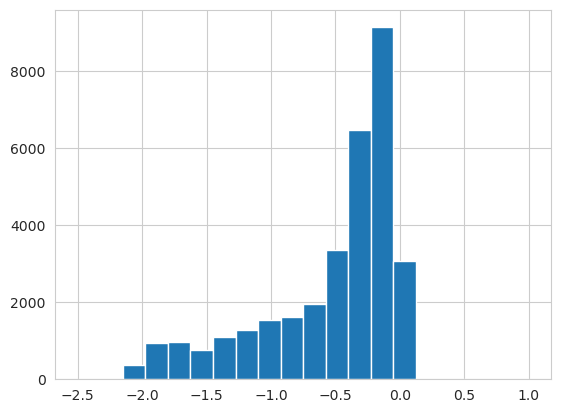

In [18]:
# cell dist distribution
plt.hist(signed_dist, bins=20, range=(-2.5, 1))
plt.show()

In [19]:
# dist threshold
dist_min, dist_max = -0.15, 0.1
bin_size = 0.03

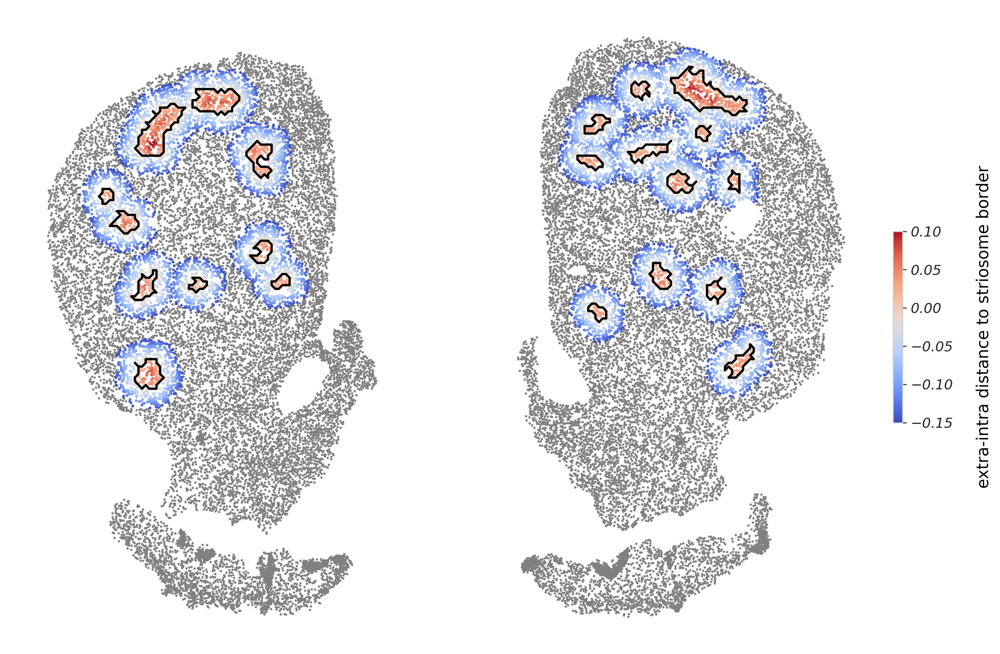

In [20]:
# plot the striosome
fig, ax = plt.subplots(figsize=(14.5, 10), dpi=300)

# filtered signed dist
keep_signed_dist = signed_dist.copy()
# not consider cells beyond the outer thredshold
keep_signed_dist[signed_dist < dist_min] = np.nan

# plot cells
ax.scatter(x = X[:,0],y = X[:,1], s=1, c='gray')
img = ax.scatter(x = X[:,0], y = X[:,1], s=2, c=keep_signed_dist, cmap='coolwarm', vmin=dist_min, vmax=dist_max)

# plot contours
for cont in contour_list:
    ax.plot(cont[:,0],cont[:,1],'k', lw = 2)

# colorbar
cbar = plt.colorbar(img, fraction=0.05, shrink=0.3, pad=0.01)
cbar.set_label('extra-intra distance to striosome border', fontsize=14, color='black', labelpad=20)
helv = fm.FontProperties(family='sans-serif', style='oblique', size=12, weight=500)
for tick in cbar.ax.get_yticklabels():
    tick.set_fontproperties(helv)


# remove grids and axises
ax.grid(False)
ax.axis("off")
ax.invert_yaxis()

plt.savefig(join(save_dir, 'border_distance.tif'), format='tif', bbox_inches='tight')
plt.show()

/tmp/ipykernel_3273016/1617633075.py:29: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.set_ticklabels(tick_labels)


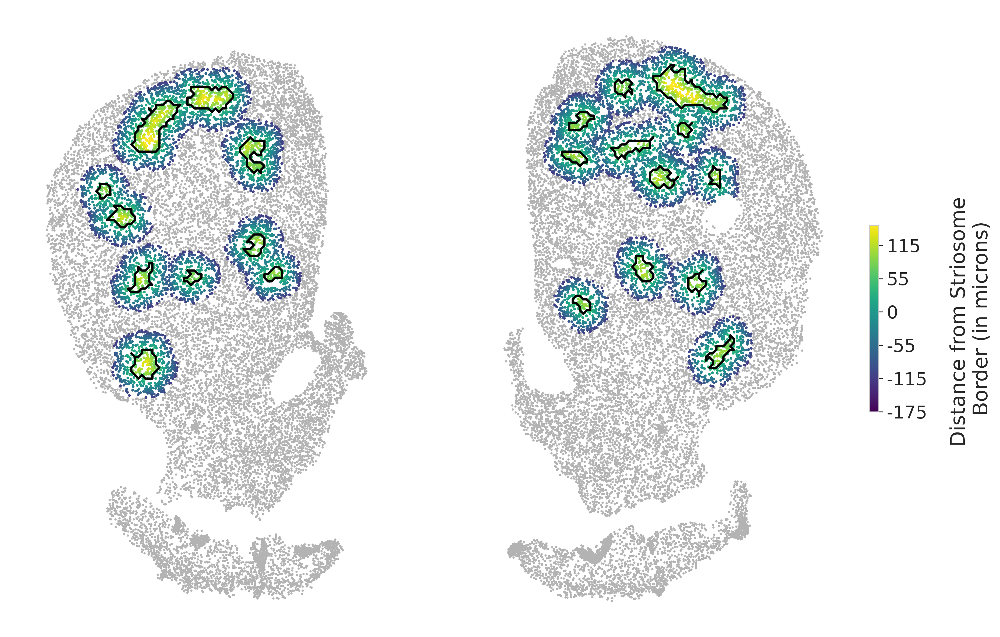

In [25]:
# plot the striosome
fig, ax = plt.subplots(figsize=(14.5, 10), dpi=300)

# filtered signed dist
keep_signed_dist = signed_dist.copy()
# not consider cells beyond the outer thredshold
keep_signed_dist[signed_dist < dist_min] = np.nan

# plot cells
ax.scatter(x = X[:,0],y = X[:,1], s=1, c='0.7')
img = ax.scatter(x = X[:,0], y = X[:,1], s=2, c=keep_signed_dist, cmap='viridis', vmin=-0.2, vmax=0.08)

# plot contours
for cont in contour_list:
    ax.plot(cont[:,0],cont[:,1],'k', lw = 2)

# colorbar
cbar = plt.colorbar(img, fraction=0.05, shrink=0.3, pad=0.01)
cbar.set_label('Distance from Striosome \nBorder (in microns)', fontsize=18, labelpad=20)
helv = fm.FontProperties(size=16)
for tick in cbar.ax.get_yticklabels():
    tick.set_fontproperties(helv)

# mannualy set the ticklabels
# cbar_ticks = (cbar.get_ticks()*1157).tolist()
# cbar_ticks = [int(t) for t in cbar_ticks]
# raw color bar ticks: [-0.15, -0.1, -0.05, 0., 0.05, 0.1]
tick_labels = [-175, -115, -55, 0, 55, 115]
cbar.set_ticklabels(tick_labels)

# remove grids and axises
ax.grid(False)
ax.axis("off")
ax.invert_yaxis()

plt.savefig(join(save_dir, 'border_distance.tif'), format='tif', bbox_inches='tight')
plt.show()

#  Cell Enrichment

Criteria for filtering cells.
- distance to the closet border
- the total number of cells
- graident ration

In [191]:
adata

AnnData object with n_obs × n_vars = 32557 × 8460
    obs: 'brain_section_label', 'cluster_alias', 'average_correlation_score', 'feature_matrix_label', 'donor_label', 'donor_genotype', 'donor_sex', 'x_section', 'y_section', 'z_section', 'neurotransmitter', 'class', 'subclass', 'supertype', 'cluster', 'neurotransmitter_color', 'class_color', 'subclass_color', 'supertype_color', 'cluster_color', 'x_reconstructed', 'y_reconstructed', 'z_reconstructed', 'parcellation_index', 'x_ccf', 'y_ccf', 'z_ccf', 'parcellation_organ', 'parcellation_category', 'parcellation_division', 'parcellation_structure', 'parcellation_substructure', 'parcellation_organ_color', 'parcellation_category_color', 'parcellation_division_color', 'parcellation_structure_color', 'parcellation_substructure_color', 'module', 'inside_detected_stri', 'closest_stri', 'closest_stri_dist'
    var: 'gene_symbol'
    uns: 'neurotransmitter_palette', 'class_palette', 'subclass_palette', 'supertype_palette', 'cluster_palette', 'parce

In [192]:
# filter based on the distance of cell types to the boarder
mask = signed_dist > dist_min
ctype_total, ctype_count = np.unique(adata.obs.loc[mask, 'supertype'].values, return_counts=True)
ctype_total

array(['0199 Lamp5 Gaba_1', '0234 STR Prox1 Lhx6 Gaba_2',
       '0236 STR Lhx8 Gaba_1', '0237 STR Lhx8 Gaba_2',
       '0239 Sst Chodl Gaba_2', '0260 PAL-STR Gaba-Chol_2',
       '0266 STR D1 Gaba_2', '0267 STR D1 Gaba_3', '0268 STR D1 Gaba_4',
       '0269 STR D1 Gaba_5', '0270 STR D1 Gaba_6', '0272 STR D1 Gaba_8',
       '0275 STR D2 Gaba_2', '0277 STR D2 Gaba_4_A*',
       '0277 STR D2 Gaba_4_B*', '0278 STR D2 Gaba_5',
       '0279 STR D2 Gaba_6', '0281 STR D1 Sema5a Gaba_1',
       '0282 STR D1 Sema5a Gaba_2', '0284 STR D1 Sema5a Gaba_4',
       '0285 STR-PAL Chst9 Gaba_1', '0286 STR-PAL Chst9 Gaba_2',
       '0287 STR-PAL Chst9 Gaba_3', '1161 Astro-TE NN_1',
       '1163 Astro-TE NN_3', '1165 Astro-TE NN_5', '1179 OPC NN_1',
       '1180 OPC NN_2', '1181 COP NN_1', '1182 NFOL NN_2',
       '1183 MFOL NN_3', '1184 MOL NN_4', '1187 VLMC NN_1',
       '1188 VLMC NN_2', '1191 Peri NN_1', '1192 SMC NN_1',
       '1193 Endo NN_1', '1194 Microglia NN_1'], dtype=object)

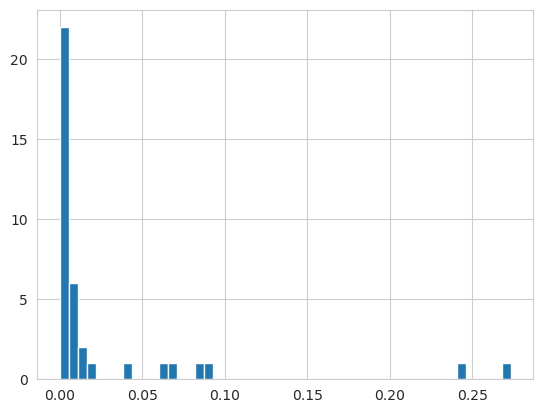

In [193]:
# cell type propertion ratio
ctype_prop = ctype_count / np.sum(ctype_count)
plt.hist(ctype_prop, bins=50)
plt.show()

In [194]:
# keep cells that at least makeup 1% of the cells within and near the striosomes.
mask = ctype_prop > 0.01
ctype_kept = ctype_total[mask]
ctype_kept

array(['0267 STR D1 Gaba_3', '0268 STR D1 Gaba_4',
       '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*',
       '0281 STR D1 Sema5a Gaba_1', '1163 Astro-TE NN_3', '1184 MOL NN_4',
       '1191 Peri NN_1', '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype=object)

## Digitize the distance

In [196]:
# calculate cell type enrichment ratio for each border bin

cell_dist = np.array(signed_dist)
cell_in_range = (cell_dist > dist_min) & (cell_dist < dist_max)
# round half to even
cell_bin = np.round(cell_dist[cell_in_range] / bin_size) * bin_size
range_ = np.unique(cell_bin)

ctype_bin_ratio = []
for cell_type in tqdm(ctype_kept, desc='calculate cell type fraction per bin'):
    # 1 for current ctype, 0 for other ctypes
    all_cells = np.array(adata.obs['supertype'] == cell_type)
    bin_ratio = ndimage.mean(all_cells[cell_in_range], cell_bin, range_)
    ctype_bin_ratio.append(bin_ratio)


# the fraction of celltype within each bin
# (n_types, n_bins)
ctype_bin_ratio = np.array(ctype_bin_ratio)
# (n_types, n_bins)
zscore_ctype_bin_ratio = (ctype_bin_ratio - np.min(ctype_bin_ratio,axis=-1,keepdims=True)) / (np.ptp(ctype_bin_ratio, axis=-1, keepdims=True))
# zscore_ctype_bin_ratio = ctype_bin_ratio
print(zscore_ctype_bin_ratio.shape)
zscore_ctype_bin_ratio

calculate cell type fraction per bin: 100%|██████████| 10/10 [00:00<00:00, 3372.98it/s]

(10, 9)


array([[0.97172955, 0.90378425, 0.97221568, 1.        , 0.82085877,
        0.38659955, 0.17236272, 0.06793809, 0.        ],
       [0.01975184, 0.01112462, 0.00416238, 0.        , 0.0543761 ,
        0.27392667, 0.53122926, 0.59730348, 1.        ],
       [0.04567306, 0.01177507, 0.        , 0.00328863, 0.06157047,
        0.30842804, 0.67184234, 0.96347882, 1.        ],
       [0.97369668, 1.        , 0.98999016, 0.92362791, 0.84083646,
        0.48568719, 0.15747916, 0.35911797, 0.        ],
       [0.56478102, 0.31374766, 0.39426752, 0.61281853, 0.5931644 ,
        1.        , 0.49095812, 0.        , 0.        ],
       [0.83861424, 0.96537742, 0.80645628, 0.8913724 , 0.99459888,
        1.        , 0.80338602, 0.70932009, 0.        ],
       [0.01590718, 0.        , 0.29908618, 0.43908118, 0.66417728,
        1.        , 0.39978362, 0.08567748, 0.38752582],
       [0.99035775, 0.94313902, 1.        , 0.92107948, 0.8915389 ,
        0.5636331 , 0.51654446, 0.73295985, 0.        ],


In [197]:
ctype_kept

array(['0267 STR D1 Gaba_3', '0268 STR D1 Gaba_4',
       '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*',
       '0281 STR D1 Sema5a Gaba_1', '1163 Astro-TE NN_3', '1184 MOL NN_4',
       '1191 Peri NN_1', '1193 Endo NN_1', '1194 Microglia NN_1'],
      dtype=object)

## filter cells based on gradient slope

In [198]:
gradient_score = []
for idx in range(len(ctype_bin_ratio)):
    model = sklearn.linear_model.LinearRegression().fit(range_.reshape(-1,1), ctype_bin_ratio[idx])
    # ln = range_*model.coef_ + model.intercept_
    gradient_score.append(model.coef_)

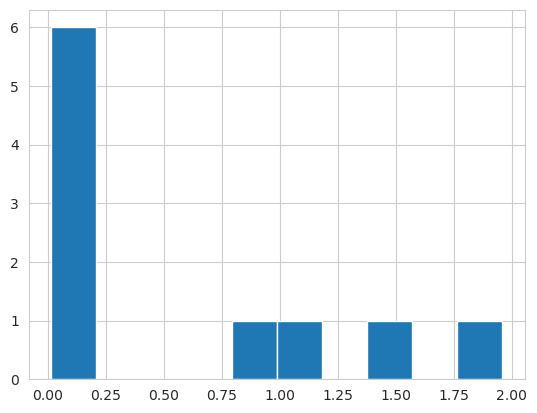

In [199]:
plt.hist(np.abs(np.array(gradient_score)), bins = 10)
plt.show()

In [200]:
# only keep cell types that show gradient slope beyond certain threshold.
slopes = np.abs(np.abs(gradient_score)).ravel()
th = np.percentile(slopes, 30)
ctype_kept = ctype_kept[slopes > th]
print(len(ctype_kept))
ctype_kept

7


array(['0267 STR D1 Gaba_3', '0268 STR D1 Gaba_4',
       '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*',
       '1163 Astro-TE NN_3', '1184 MOL NN_4', '1193 Endo NN_1'],
      dtype=object)

In [201]:
cell_dist = np.array(signed_dist)
cell_in_range = (cell_dist > dist_min) & (cell_dist < dist_max)
cell_bin = np.round(cell_dist[cell_in_range] / bin_size) * bin_size
range_ = np.unique(cell_bin)

ctype_bin_ratio = []
for cell_type in tqdm(ctype_kept, desc='calculate celltype fraction per bin'):
    all_cells = np.array(adata.obs['supertype'] == cell_type)
    bin_ratio = ndimage.mean(all_cells[cell_in_range], cell_bin, range_)
    ctype_bin_ratio.append(bin_ratio)


# the fraction of celltype within each bin
# (n_types, n_bins)
ctype_bin_ratio = np.array(ctype_bin_ratio)
# (n_types, n_bins)
zscore_ctype_bin_ratio = (ctype_bin_ratio - np.min(ctype_bin_ratio, axis=-1, keepdims=True)) / (np.ptp(ctype_bin_ratio, axis=-1, keepdims=True))
# zscore_cellTypeEnrich  = Binned_cellType_enrich
print(zscore_ctype_bin_ratio.shape)
zscore_ctype_bin_ratio

calculate celltype fraction per bin: 100%|██████████| 7/7 [00:00<00:00, 1453.11it/s]

(7, 9)


array([[0.97172955, 0.90378425, 0.97221568, 1.        , 0.82085877,
        0.38659955, 0.17236272, 0.06793809, 0.        ],
       [0.01975184, 0.01112462, 0.00416238, 0.        , 0.0543761 ,
        0.27392667, 0.53122926, 0.59730348, 1.        ],
       [0.04567306, 0.01177507, 0.        , 0.00328863, 0.06157047,
        0.30842804, 0.67184234, 0.96347882, 1.        ],
       [0.97369668, 1.        , 0.98999016, 0.92362791, 0.84083646,
        0.48568719, 0.15747916, 0.35911797, 0.        ],
       [0.83861424, 0.96537742, 0.80645628, 0.8913724 , 0.99459888,
        1.        , 0.80338602, 0.70932009, 0.        ],
       [0.01590718, 0.        , 0.29908618, 0.43908118, 0.66417728,
        1.        , 0.39978362, 0.08567748, 0.38752582],
       [0.98566329, 1.        , 0.73887022, 0.74634498, 0.81454032,
        0.82632219, 0.92064364, 0.45962637, 0.        ]])

In [202]:
ctype_kept

array(['0267 STR D1 Gaba_3', '0268 STR D1 Gaba_4',
       '0277 STR D2 Gaba_4_A*', '0277 STR D2 Gaba_4_B*',
       '1163 Astro-TE NN_3', '1184 MOL NN_4', '1193 Endo NN_1'],
      dtype=object)

In [203]:
# sort the cell types (also remove unrelated cell types)
ctype_order = ['0277 STR D2 Gaba_4_B*', '0267 STR D1 Gaba_3', '1193 Endo NN_1', '1163 Astro-TE NN_3', '1184 MOL NN_4', '0277 STR D2 Gaba_4_A*', '0268 STR D1 Gaba_4']
ctype_sort_idx = [np.where(ctype_kept == nm)[0].item() for nm in ctype_order]
ctype_sort_idx

[3, 0, 6, 4, 5, 2, 1]

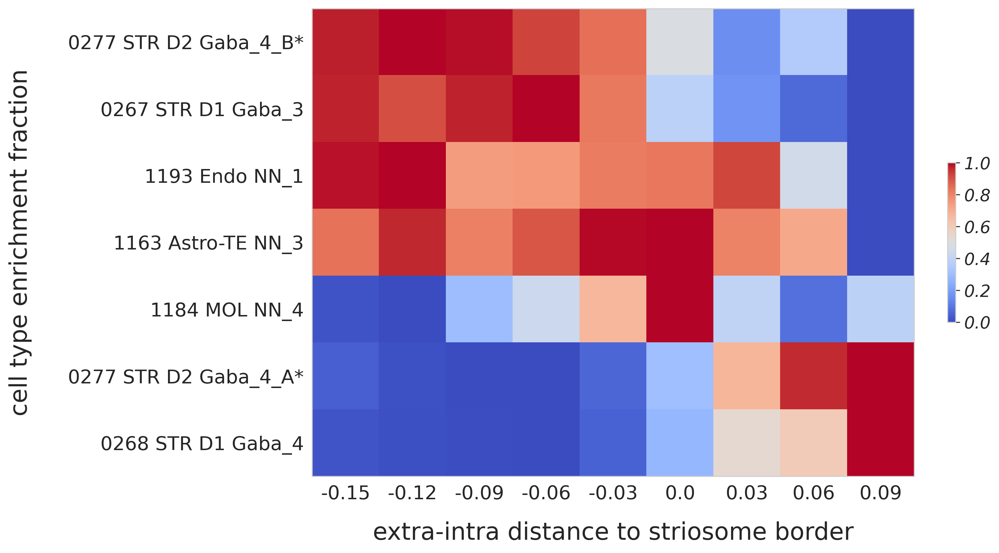

In [241]:
fig, ax = plt.subplots(figsize=(10, 8), dpi=300)

# heatmap
im = ax.imshow(zscore_ctype_bin_ratio[ctype_sort_idx], cmap='coolwarm', vmin=0, vmax=1)

# colorbar
cbar = plt.colorbar(im, fraction=0.05, shrink=0.3, pad=0.05)
helv = fm.FontProperties(family='sans-serif', style='oblique', size=14, weight=500)
for tick in cbar.ax.get_yticklabels():
    tick.set_fontproperties(helv)


# ticks and tick labels
ax.set_xticks(range(len(range_)), labels=range_, fontsize=16)
ax.set_yticks(range(len(ctype_sort_idx)), labels=ctype_kept[ctype_sort_idx].tolist(), fontsize=16)

# cancel ticklines
ax.tick_params(axis='both', grid_alpha=0)

ax.set_xlabel('striosome out-in distance', fontsize=20, labelpad=15)
# peri-striosome, border, striosome center
# ax.set_xlabel('    peri-striosome    |    border    |    striosome center', fontsize=20, labelpad=15)
# ax.set_xlabel('                   extra-striosome   |   border   |   intra-striosome', fontsize=20, labelpad=15)
ax.set_xlabel('extra-intra distance to striosome border', fontsize=20, labelpad=15)
ax.set_ylabel('cell type enrichment fraction', fontsize=20, labelpad=30)
# plt.tight_layout()

plt.savefig(join(save_dir, 'cell_type_enrichment.tif'), format='tif', bbox_inches="tight")
plt.show()

# Gene Expression

In [225]:
cell_dist = np.array(signed_dist)
cell_in_range = (cell_dist > dist_min) & (cell_dist < dist_max)
cell_bin = np.round(cell_dist[cell_in_range] / bin_size) * bin_size
range_ = np.unique(cell_bin)

gene_bin_ratio = []
for gn in tqdm(adata.var_names, desc='calculate gene fraction per bin'):
    # all_cells_gene = np.array(adata[:, gn].X).squeeze()
    all_cells_gene = adata[:, gn].X.toarray().squeeze()
    Xpr_bin_gn = ndimage.mean(all_cells_gene[cell_in_range], cell_bin, range_)
    gene_bin_ratio.append(Xpr_bin_gn)
gene_bin_ratio = np.array(gene_bin_ratio)

# z-score normalization
zscore_gene_bin_ratio = (gene_bin_ratio - np.min(gene_bin_ratio, axis=-1, keepdims=True)) / (np.ptp(gene_bin_ratio, axis=-1, keepdims=True))
# zscore_gene_bin_ratio = gene_bin_ratio
print(zscore_gene_bin_ratio.shape)


calculate gene fraction per bin: 100%|██████████| 8460/8460 [03:19<00:00, 42.35it/s]

(8460, 9)



/tmp/ipykernel_1300894/3520098390.py:16: RuntimeWarning: invalid value encountered in divide
  zscore_gene_bin_ratio = (gene_bin_ratio - np.min(gene_bin_ratio, axis=-1, keepdims=True)) / (np.ptp(gene_bin_ratio, axis=-1, keepdims=True))


In [226]:
# reset NA data
# zscore_Binned_gene_enrich[np.isnan(zscore_Binned_gene_enrich)] = 0.0
zscore_gene_bin_ratio[np.isnan(zscore_gene_bin_ratio)] = 0.0

In [227]:
kmeans_cls = sklearn.cluster.KMeans(n_clusters = 2).fit(zscore_gene_bin_ratio).labels_
print(np.unique(kmeans_cls, return_counts=True))
kmeans_cls

(array([0, 1], dtype=int32), array([3385, 5075]))


array([0, 1, 1, ..., 0, 1, 1], dtype=int32)

In [228]:
# reorder the data based on classes
gene_sort_idx = []
for k in [1,0]:
    keep = (kmeans_cls == k)
    gene_sort_idx += [np.where(keep)[0]]
gene_sort_idx = np.hstack(gene_sort_idx)

In [229]:
# select out gene indexes (aftering reordering)
genes = ['Penk', 'Adam12', 'Gfap', 'Olig1', 'Oprm1', 'Pdyn', 'Tac1']
gene_idxes = []
for g in genes:
    pos = (adata.var['gene_symbol'].iloc[gene_sort_idx] == g).to_numpy().argmax().item()
    gene_idxes.append(pos)
print(gene_idxes)
kmeans_cls[gene_sort_idx][gene_idxes]

[464, 718, 4017, 3921, 5656, 6236, 6275]


array([1, 1, 1, 1, 0, 0, 0], dtype=int32)

In [230]:
def draw_line2text(ax, text, pos, direction='up'):

    if direction == 'up':
        offset = -150
    elif direction == 'down':
        offset = 150
    elif direction == 'hor':
        offset = 0
    else:
        offset = 0

    ax.annotate(
        text,              # text
        xy=( -0.5, pos),             # arrow location
        xycoords='data',
        xytext=(-0.85, pos + offset),         # text location
        textcoords='data',
        arrowprops=dict(
            arrowstyle="->",           # arrow stype
            color="black",
            lw=1.2
        ),
        ha="right", va="bottom", color="black", size=14
    )

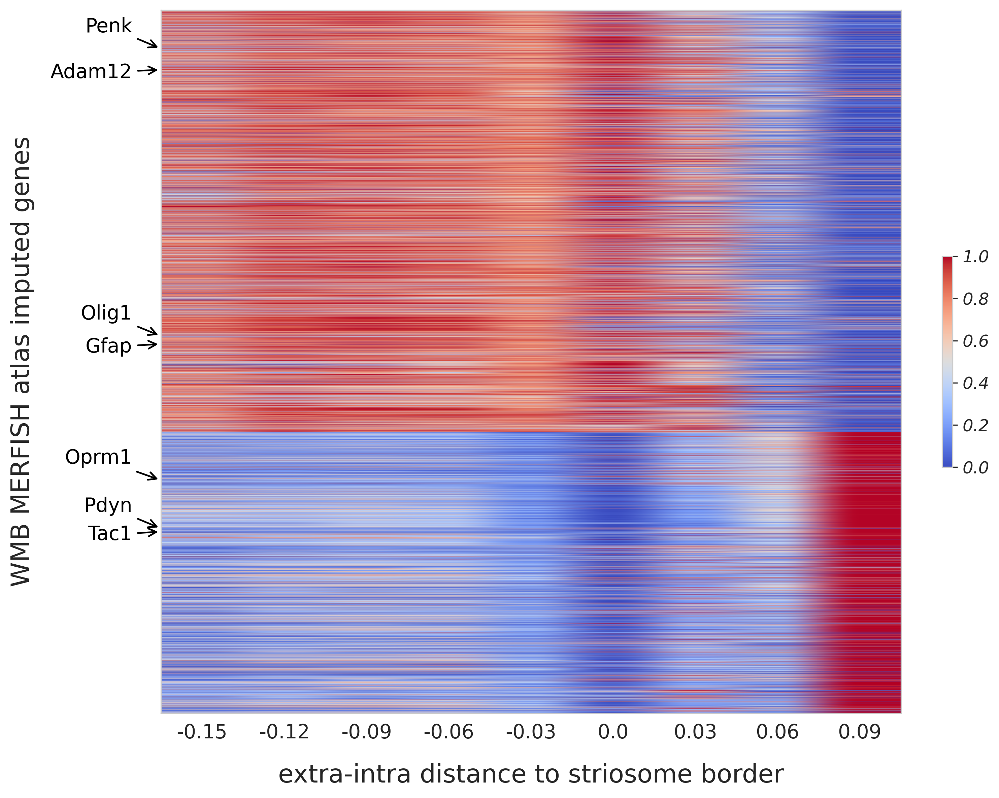

In [243]:
fig, ax = plt.subplots(figsize=(10, 8), dpi=300)

# heatmap
im = ax.imshow(zscore_gene_bin_ratio[gene_sort_idx], cmap='coolwarm', vmin=0, vmax=1, aspect='auto')

# colorbar
cbar = plt.colorbar(im, fraction=0.05, shrink=0.3, pad=0.05)
# cbar.set_label('normalized gene expression intensity', fontsize=12, color='black')
helv = fm.FontProperties(family='sans-serif', style='oblique', size=12, weight=500)
for tick in cbar.ax.get_yticklabels():
    tick.set_fontproperties(helv)


# ticks and tick labels
ax.set_xticks(range(len(range_)), labels=range_, fontsize=14)
ax.set_yticks([])
# cancel x ticklines
ax.tick_params(axis='both', grid_alpha=0)


draw_line2text(ax, 'Penk', 464, 'up')
draw_line2text(ax, 'Adam12', 718, 'down')
draw_line2text(ax, 'Olig1', 3921, 'up')
draw_line2text(ax, 'Gfap', 4017, 'down')
draw_line2text(ax, 'Oprm1', 5656, 'up')
draw_line2text(ax, 'Pdyn', 6236, 'up')
draw_line2text(ax, 'Tac1', 6275, 'down')


ax.set_xlabel('extra-intra distance to striosome border', fontsize=18, labelpad=15)
ax.set_ylabel('WMB MERFISH atlas imputed genes', fontsize=18, labelpad=90)
plt.tight_layout()

plt.savefig(join(save_dir, 'gene_enrichment.tif'), format='tif', bbox_inches='tight')

plt.show()

# Cell distributions

In [217]:
def plot_stri_cell_distribution(stype, color=None, saving_name=None):
    fig, ax = plt.subplots(figsize=(11, 8), dpi=300)
    dot_size=0.2
    focus_degree=5


    # plot the striosome adjacent region
    ddfn = signed_dist.copy()
    # do not consider cells beyond the outer thredshold
    ddfn[signed_dist < dist_min] = np.nan
    region_mask = (~ddfn.isna())
    ax.scatter(x=X[:,0], y=X[:,1], s=dot_size, c='0.6')
    ax.scatter(x=X[region_mask, 0], y=X[region_mask, 1], s=dot_size, c='lightgrey')

    for cont in contour_list:
        ax.plot(cont[:, 0], cont[:, 1], 'k', lw=1)

    # plot the cells
    stype_mask = adata.obs['supertype'] == stype
    mask = (region_mask & stype_mask)
    if color is None:
        color = adata.uns['supertype_palette'][stype]
    ax.scatter(x=X[mask, 0], y=X[mask, 1], s=dot_size*focus_degree, c=color)

    ax.grid(False)
    ax.axis("off")

    ax.invert_yaxis()
    ax.set_title('[{}] spatial distribution in striosome adjacent area'.format(stype), fontsize=14)

    if saving_name:
        plt.savefig(join(save_dir, saving_name), format='tif', bbox_inches="tight")

    plt.show()

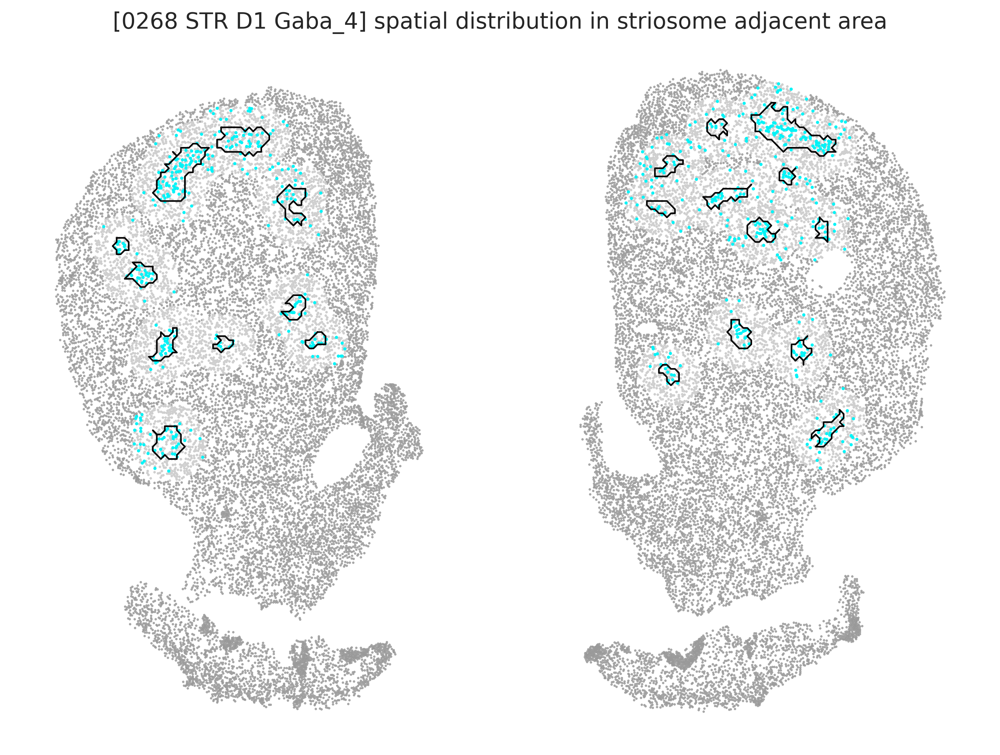

In [218]:
plot_stri_cell_distribution('0268 STR D1 Gaba_4', saving_name='cell_spatial_0268_STR_D1_Gaba_4.tif')

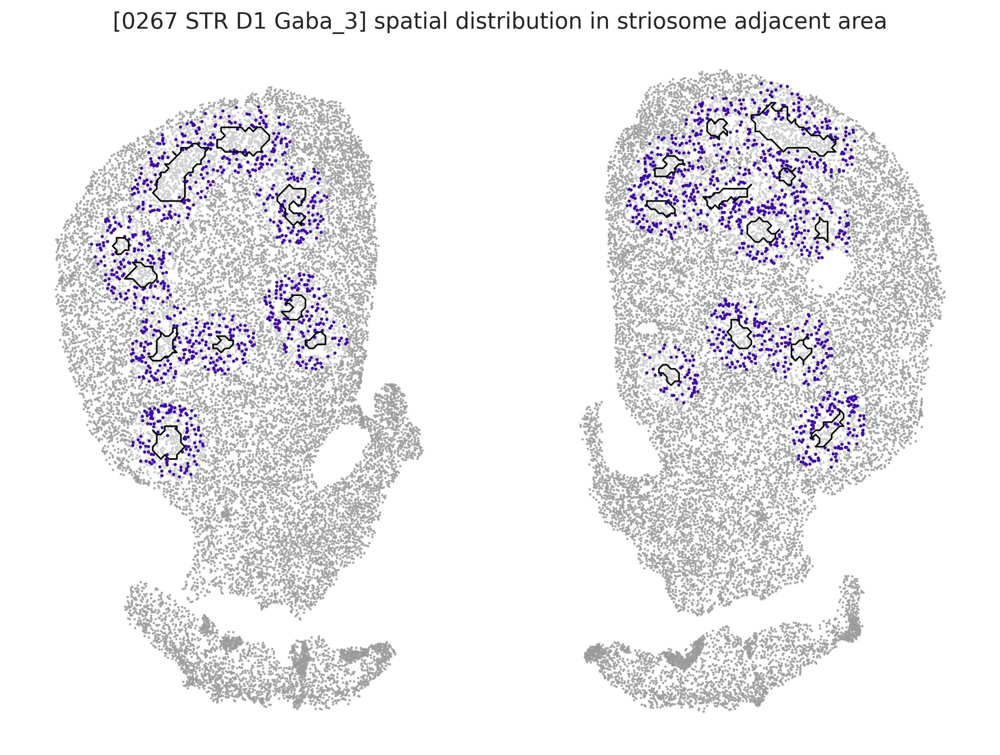

In [219]:
plot_stri_cell_distribution('0267 STR D1 Gaba_3', saving_name='cell_spatial_0267_STR_D1_Gaba_3.tif')

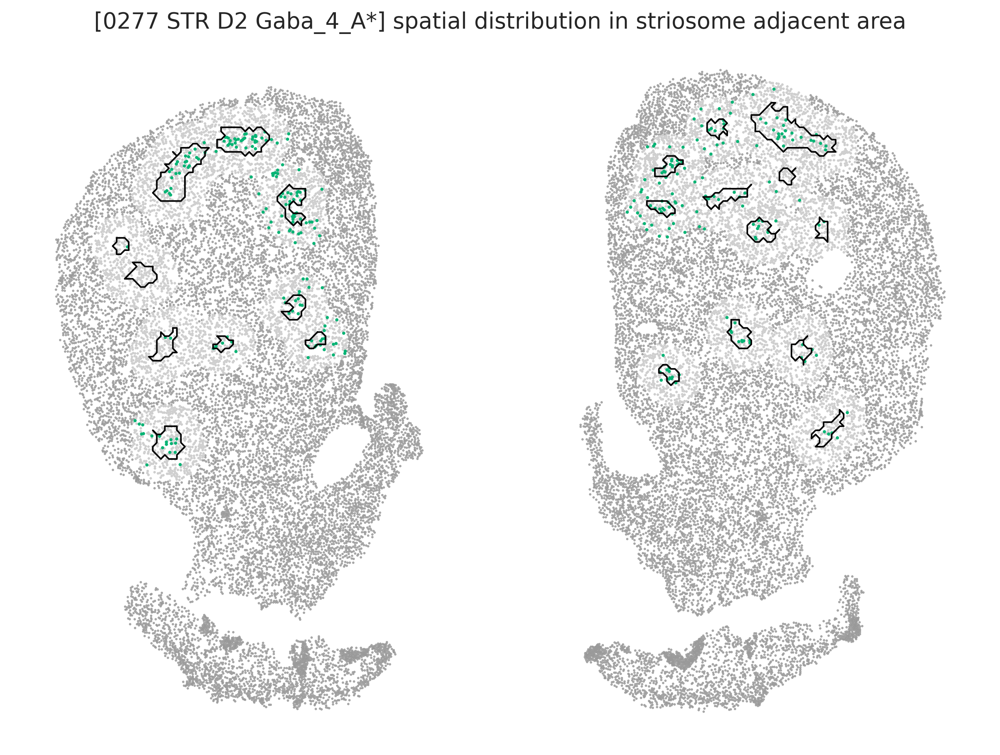

In [220]:
plot_stri_cell_distribution('0277 STR D2 Gaba_4_A*', saving_name='cell_spatial_0277_STR_D2_Gaba_4_A*.tif')

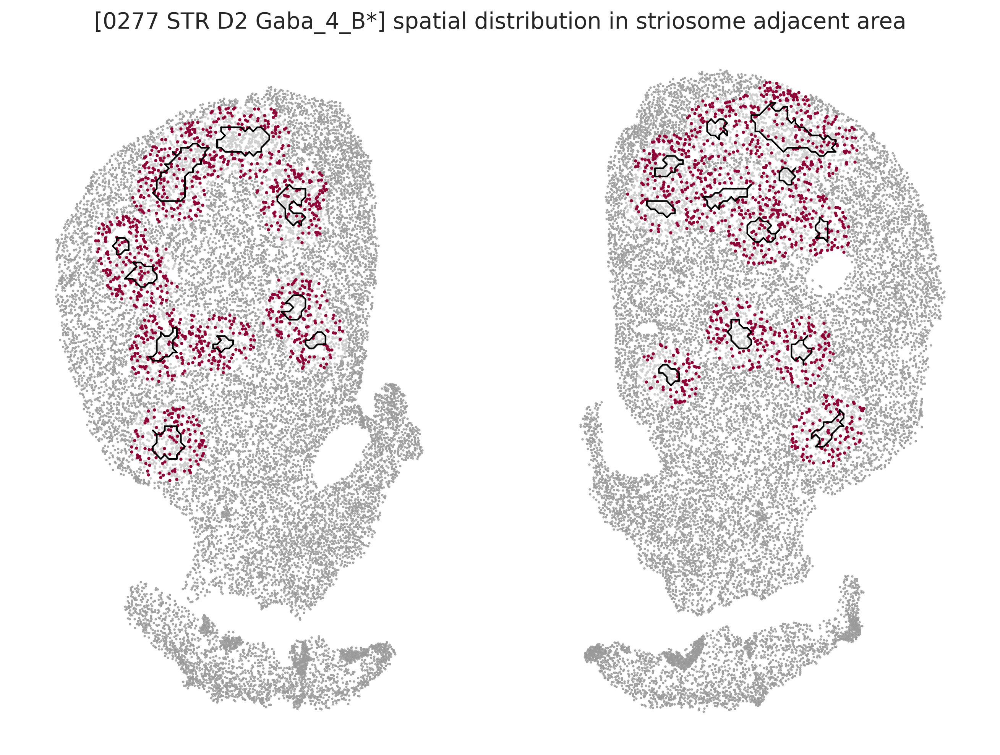

In [221]:
plot_stri_cell_distribution('0277 STR D2 Gaba_4_B*', saving_name='cell_spatial_0277_STR_D2_Gaba_4_B*.tif')

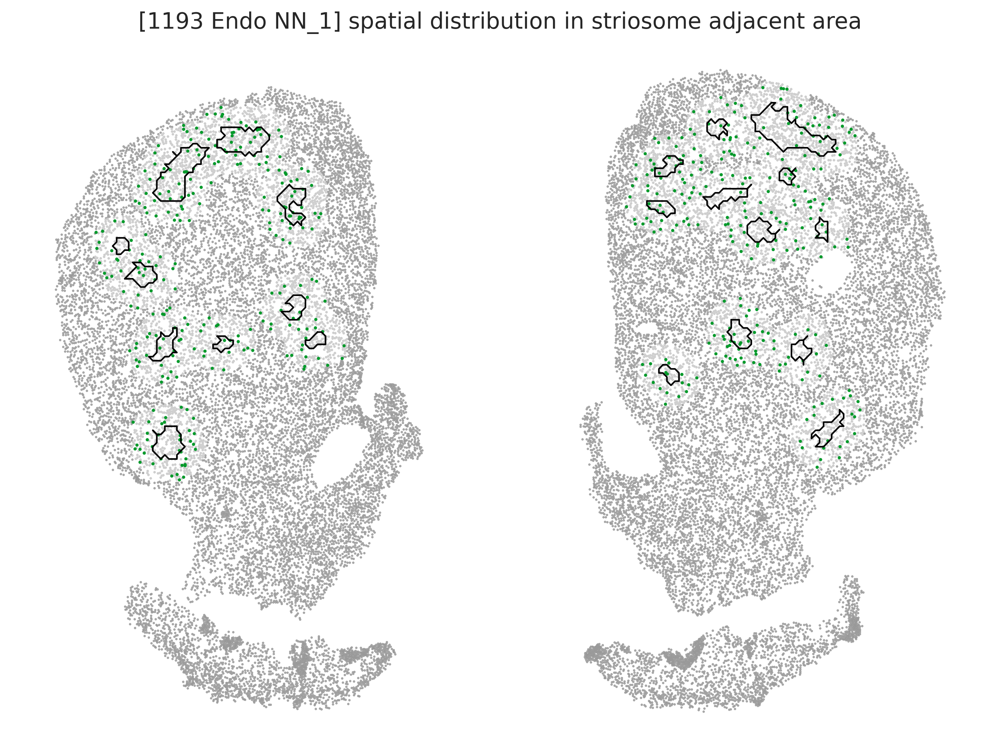

In [222]:
plot_stri_cell_distribution('1193 Endo NN_1', saving_name='cell_spatial_1193_Endo_NN_1.tif')

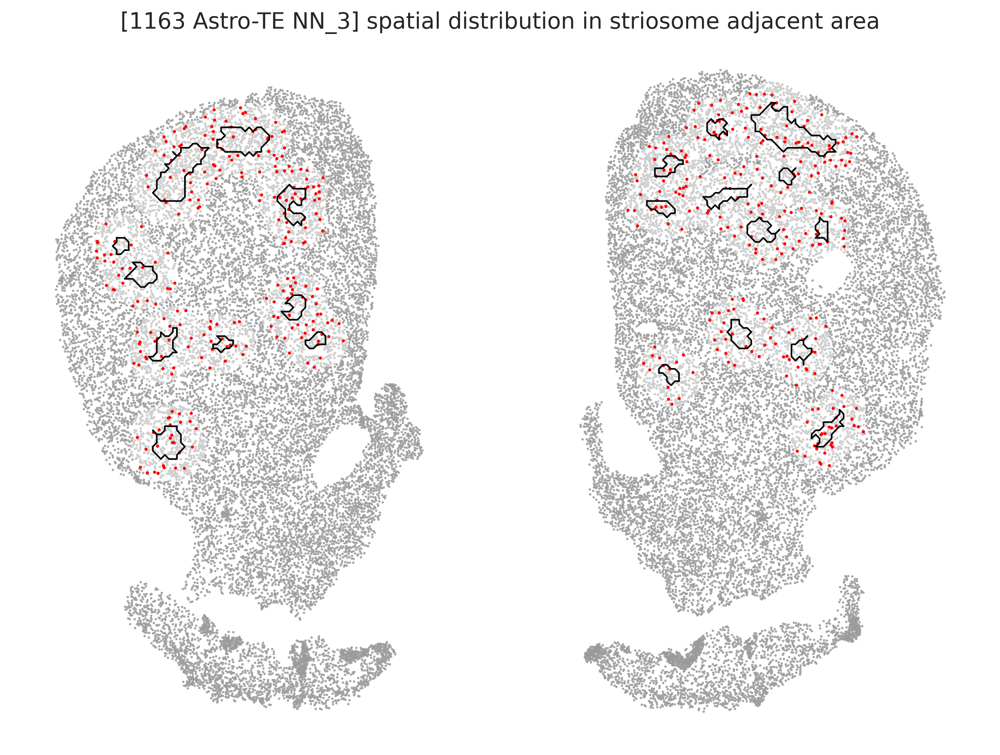

In [223]:
plot_stri_cell_distribution('1163 Astro-TE NN_3', 'r', saving_name='cell_spatial_1163 Astro-TE_NN_3.tif')

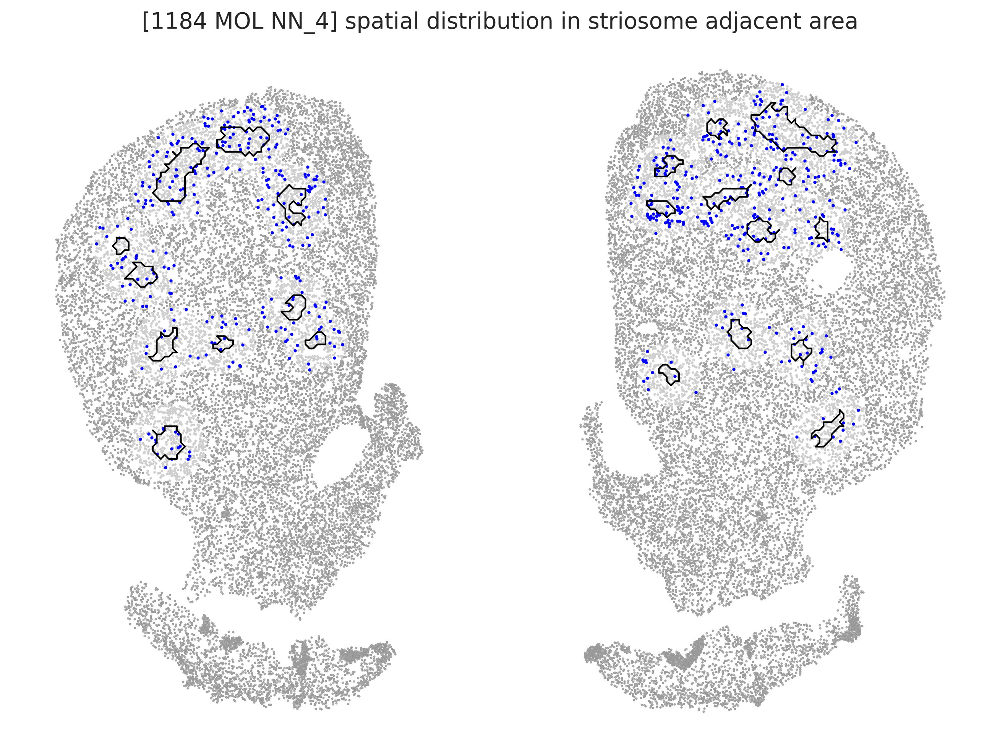

In [224]:
plot_stri_cell_distribution('1184 MOL NN_4', 'b', saving_name='cell_spatial_1184_MOL_NN_4.tif')

# Gene dirtributions

In [285]:
def plot_stri_gene_distribution(gene, expr_thred=1, do_normal=True, only_region=True, saving_name=None):
    fig, ax = plt.subplots(figsize=(11.5, 8), dpi=300)

    # dot_size = 0.15
    dot_size=0.2
    focus_degree=2

    # plot the striosome adjacent region
    ddfn = cell_dist.copy()
    # do not consider cells beyond the outer thredshold
    ddfn[cell_dist < dist_min] = np.nan
    region_mask = (~np.isnan(ddfn))
    ax.scatter(x = X[:,0],y = X[:,1], s=dot_size, c='0.6')
    ax.scatter(x = X[region_mask,0],y = X[region_mask,1], s=dot_size, c='lightgrey')
    for cont in contour_list:
        ax.plot(cont[:,0], cont[:,1], 'k', lw = 1)


    # plot the cells
    assert (adata.var['gene_symbol'] == gene).any(), 'gene {} does not exist'.format(gene)
    if only_region:
        if do_normal:
            expr = adata[region_mask, adata.var['gene_symbol'] == gene].X.squeeze()
            zscore_expr = (expr - np.min(expr)) / (np.ptp(expr))
            ax_img = ax.scatter(x = X[region_mask, 0], y = X[region_mask, 1], s=dot_size*focus_degree, c=zscore_expr, cmap='viridis', vmin=0, vmax=expr_thred)
        else:
            ax_img = ax.scatter(x = X[region_mask, 0], y = X[region_mask, 1], s=dot_size*focus_degree, c=adata[region_mask, adata.var['gene_symbol'] == gene].X, cmap='viridis', vmin=0, vmax=expr_thred)
    else:
        if do_normal:
            expr = adata[:, adata.var['gene_symbol'] == gene].X.squeeze()
            zscore_expr = (expr - np.min(expr)) / (np.ptp(expr))
            ax_img = ax.scatter(x = X[:, 0], y = X[:, 1], s=dot_size*focus_degree, c=zscore_expr, cmap='viridis', vmin=0, vmax=expr_thred)
        else:
            ax_img = ax.scatter(x = X[:, 0], y = X[:, 1], s=dot_size*focus_degree, c=adata[:, adata.var['gene_symbol'] == gene].X, cmap='viridis', vmin=0, vmax=expr_thred)

    # fig.colorbar(ax_img)

    # colorbar
    cbar = fig.colorbar(ax_img, fraction=0.05, shrink=0.3, pad=0.03)
    cbar.set_label('normalized gene expression value', fontsize=12, color='black', labelpad=15)
    helv = fm.FontProperties(family='sans-serif', style='oblique', size=12, weight=500)
    for tick in cbar.ax.get_yticklabels():
        tick.set_fontproperties(helv)


    ax.invert_yaxis()
    ax.grid(False)
    ax.axis("off")
    ax.set_title('[{}] spatial distribution'.format(gene), size=14)

    if saving_name:
        plt.savefig(join(save_dir, saving_name), format='tif', bbox_inches='tight')

    plt.show()

In [263]:
['Penk', 'Adam12', 'Gfap', 'Olig1', 'Oprm1', 'Pdyn', 'Tac1']

['Penk', 'Adam12', 'Gfap', 'Olig1', 'Oprm1', 'Pdyn', 'Tac1']

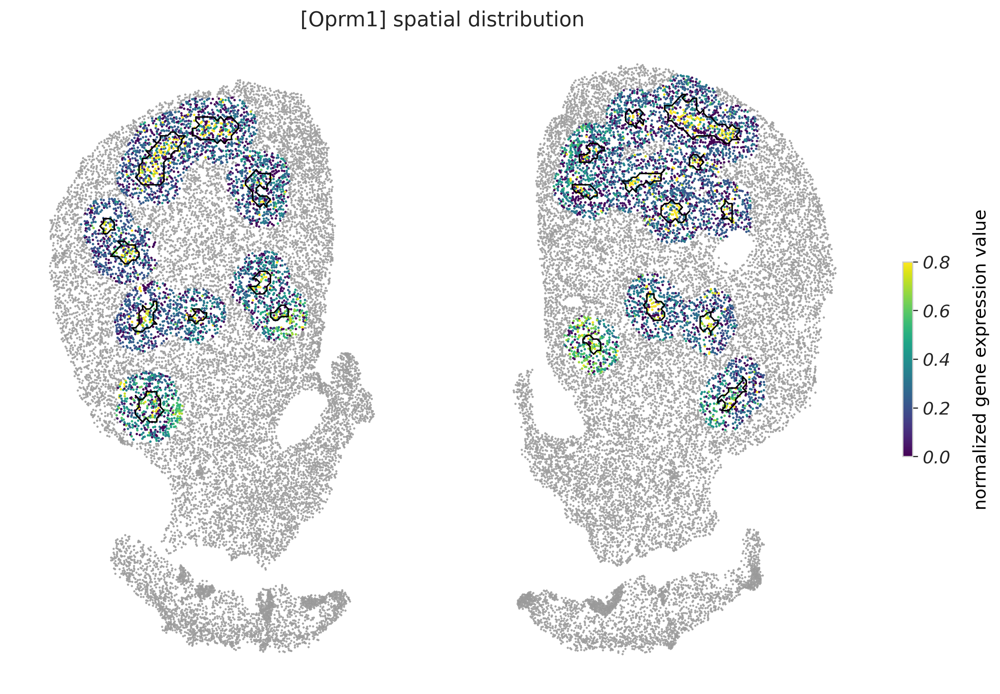

In [286]:
plot_stri_gene_distribution('Oprm1', expr_thred=0.8, saving_name='gene_spatial_Oprm1.tif')

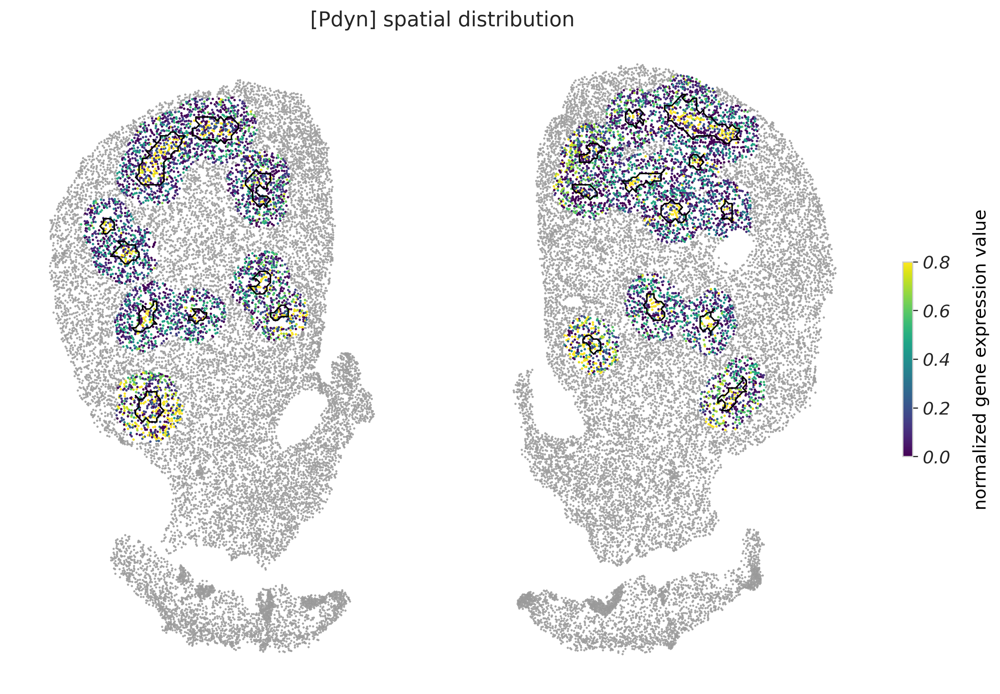

In [287]:
plot_stri_gene_distribution('Pdyn', expr_thred=0.8, saving_name='gene_spatial_Pdyn.tif')

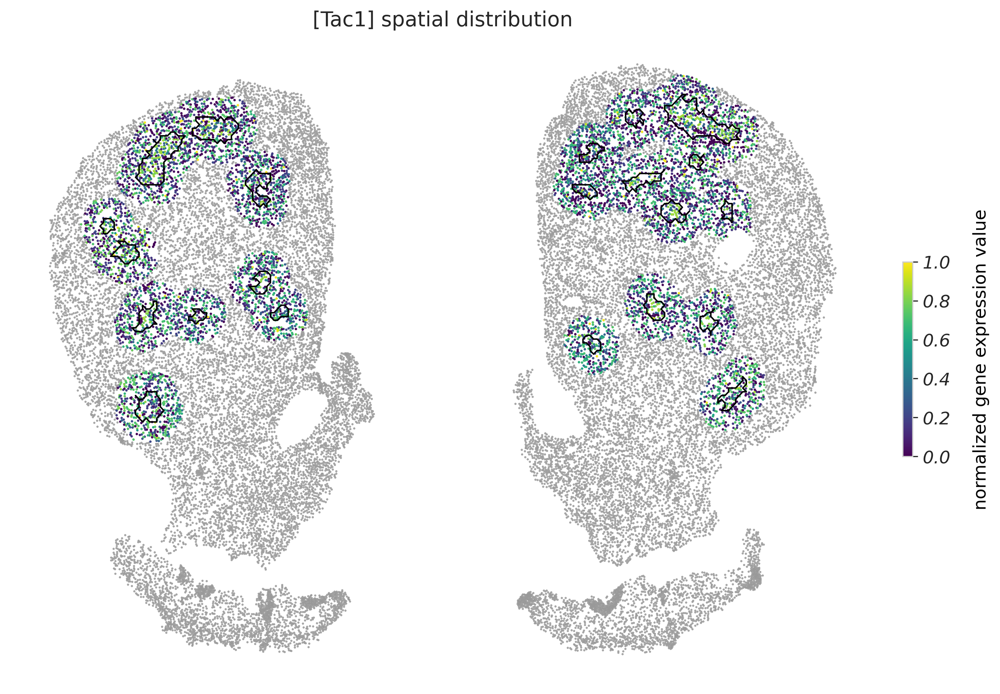

In [293]:
plot_stri_gene_distribution('Tac1', saving_name='gene_spatial_Tac1.tif')

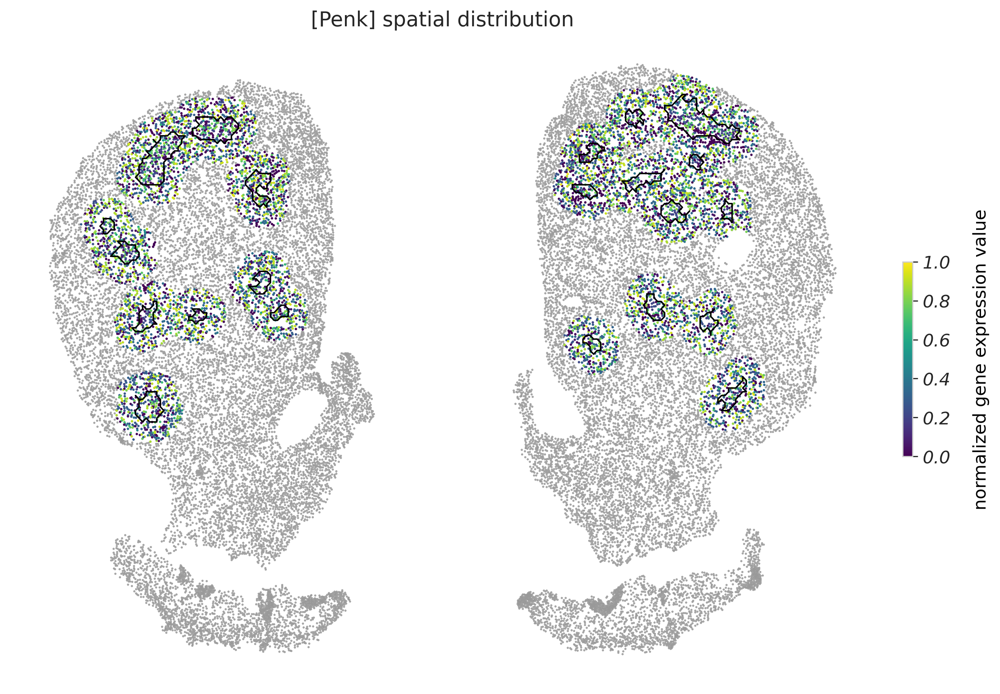

In [292]:
plot_stri_gene_distribution('Penk', saving_name='gene_spatial_Penk.tif')

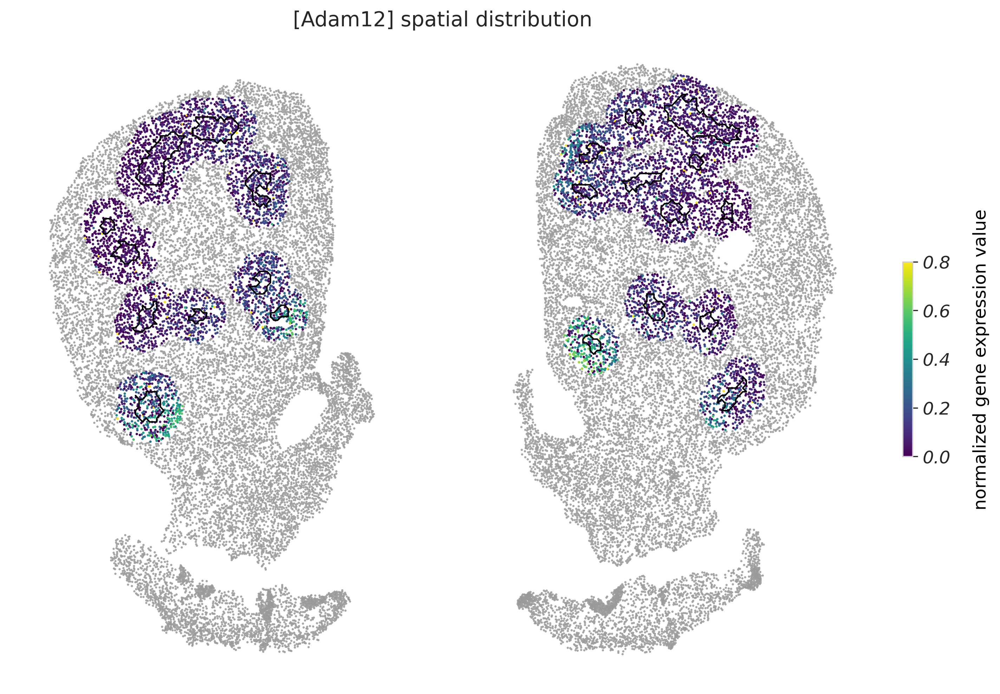

In [297]:
plot_stri_gene_distribution('Adam12', expr_thred=0.8, saving_name='gene_spatial_Adam12.tif')

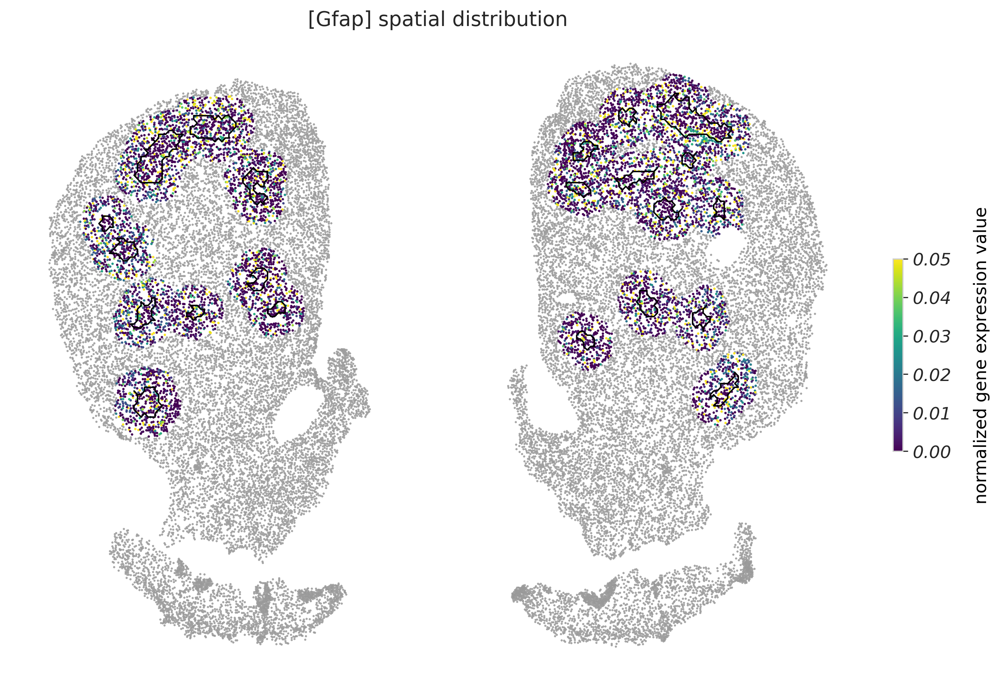

In [280]:
plot_stri_gene_distribution('Gfap', expr_thred=0.05, saving_name='gene_spatial_Gfap.tif')

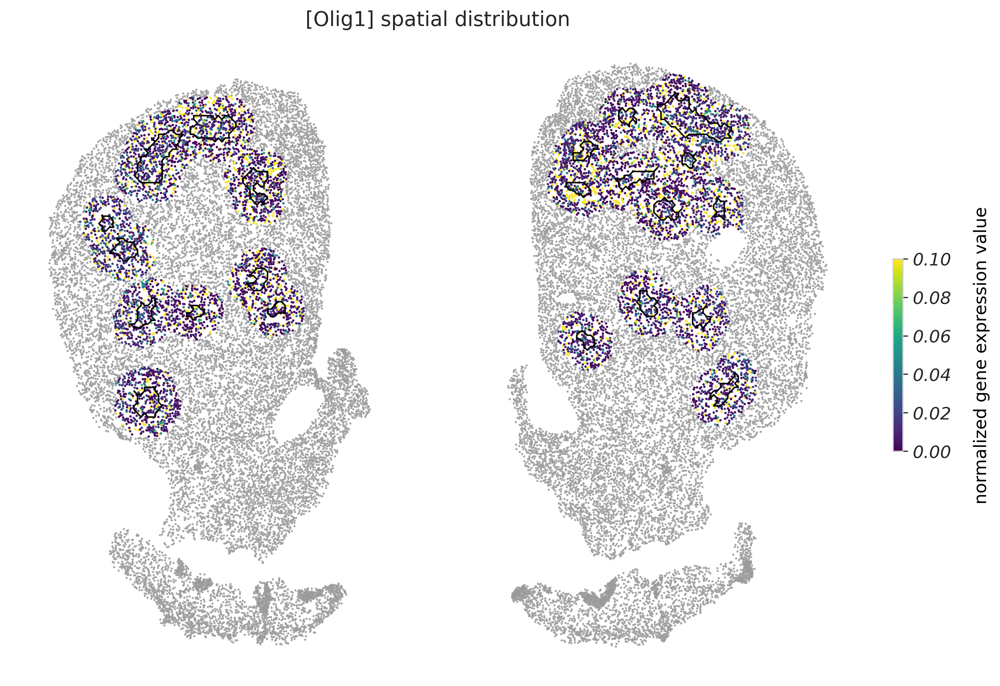

In [298]:
plot_stri_gene_distribution('Olig1', expr_thred=0.1, saving_name='gene_spatial_Olig1.tif')